<a href="https://colab.research.google.com/github/Nourjeday/Fishing_Detection/blob/main/Fishing_Detection_R_CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Fishing Detection with R-CNN
* Project Overview
This project focuses on detecting various objects (swimmer, boat, jetski, life-saving appliances, and buoy) in fishing-restricted areas using a Faster R-CNN model, specifically tailored for real-time detection. The goal is to enhance safety and compliance in restricted fishing zones.

## Key Features
* Object Detection: Detects multiple objects such as swimmers, boats, jetskis, life-saving appliances, and buoys.

* Model: Uses Faster R-CNN with a MobileNetV3 backbone for efficient detection.
* Metrics: Evaluates model performance using mean Average Precision (mAP).

* Requirements
Python 3.x

PyTorch

TorchVision

TensorBoard

TorchMetrics

PyCOCOtools


* Training the Model
The model is trained using Faster R-CNN with MobileNetV3 backbone. Here’s how to train the model:

* Load Data: Prepare your custom dataset in COCO format.



# Perform detection on a new image
image = Image.open("<path-to-image>")
detections = model([image])
Evaluation Metrics
The model evaluates on the following metrics:

mAP (mean Average Precision)

mAP@50IoU and mAP@75IoU: Precision metrics at different Intersection over Union thresholds.

Size-Based mAP: mAP computed for small, medium, and large objects.

Results
Sample results from training:

Metric	Value
mAP	0.3183
mAP@50IoU	0.6160
mAP@75IoU	0.2848
mAP Small	0.3158
mAP Medium	0.4787
mAP Large	0.5193
License
MIT License



In [1]:
!sudo apt-get install tree
!pip install -qq torchmetrics[detection]
!pip install -qq pycocotools
!pip install -qq tensorboard

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  tree
0 upgraded, 1 newly installed, 0 to remove and 30 not upgraded.
Need to get 47.9 kB of archives.
After this operation, 116 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tree amd64 2.0.2-1 [47.9 kB]
Fetched 47.9 kB in 0s (136 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package tree.
(Reading database ... 126213 files and directories currently install

In [2]:
!git clone https://github.com/pytorch/vision.git


Cloning into 'vision'...
remote: Enumerating objects: 626659, done.
remote: Counting objects: 100% (896/896), done.
remote: Compressing objects: 100% (761/761), done.
remote: Total 626659 (delta 818), reused 136 (delta 135), pack-reused 625763 (from 5)
Receiving objects: 100% (626659/626659), 1.16 GiB | 32.81 MiB/s, done.
Resolving deltas: 100% (586155/586155), done.


In [3]:
import os
import gc
import json
import math
import sys
import random
import requests
import zipfile
import numpy as np
from PIL import Image, ImageDraw, ImageFont, ImageOps, ImageStat
import PIL
from torchsummary import summary
import torch
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.utils.tensorboard import SummaryWriter
sys.path.append('/content/vision/references/detection')
from utils import MetricLogger, SmoothedValue, collate_fn
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import Patch
import logging
from tqdm import tqdm

from torchmetrics.detection.mean_ap import MeanAveragePrecision
from dataclasses import dataclass
import torchvision
from vision.references.detection import utils

import torchvision.transforms as T
from torchvision.transforms import v2 as Tv2
from torchvision import tv_tensors
from torchvision.transforms import functional as F
from torchvision.transforms.functional import to_pil_image
from torch.utils.tensorboard import SummaryWriter
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from tqdm import tqdm
from tabulate import tabulate
import torchvision.models.detection as detection
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.transform import GeneralizedRCNNTransform

In [4]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# **Download Dataset - Preprocessed as patches**

In [5]:
sea_drone_dir = "SeaDroneSee"
os.makedirs(sea_drone_dir, exist_ok=True)

!wget -O {sea_drone_dir}/SeaDroneSee.zip "https://www.dropbox.com/scl/fi/0oyv9pki57laqgmq7matd/SeaDroneSee.zip?rlkey=yasyxr0u3450dylv5musks1s0&st=q12t3tc3&dl=1"

--2025-04-10 07:40:32--  https://www.dropbox.com/scl/fi/0oyv9pki57laqgmq7matd/SeaDroneSee.zip?rlkey=yasyxr0u3450dylv5musks1s0&st=q12t3tc3&dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.18, 2620:100:6022:18::a27d:4212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://uc0e781ec48d4476e17f86e46f39.dl.dropboxusercontent.com/cd/0/inline/CnhcsQRvj_RZkx1xFwJzPsohUCDafO4hhLiaudm6m49jITnJLzrq4eMqgMyECFoj9rGRfnDilCvT0ybIki8dVkaMhNgTF8253czRHiwlA_nfdtb1T8oHTWt-dkhYTYbQDiXYpGRcKJsG-ApX2vrmlCoq/file?dl=1# [following]
--2025-04-10 07:40:33--  https://uc0e781ec48d4476e17f86e46f39.dl.dropboxusercontent.com/cd/0/inline/CnhcsQRvj_RZkx1xFwJzPsohUCDafO4hhLiaudm6m49jITnJLzrq4eMqgMyECFoj9rGRfnDilCvT0ybIki8dVkaMhNgTF8253czRHiwlA_nfdtb1T8oHTWt-dkhYTYbQDiXYpGRcKJsG-ApX2vrmlCoq/file?dl=1
Resolving uc0e781ec48d4476e17f86e46f39.dl.dropboxusercontent.com (uc0e781ec48d4476e17f86e46f39.dl.dropboxusercon

In [6]:
!wget -O {sea_drone_dir}/SeaDroneSee_test.zip "https://www.dropbox.com/scl/fi/4qidpahgu9mogam33uxlz/SeaDroneSee_test.zip?rlkey=1gt6mebuppxg4ehzhicwqafav&st=5g01mcdb&dl=1"

--2025-04-10 07:47:06--  https://www.dropbox.com/scl/fi/4qidpahgu9mogam33uxlz/SeaDroneSee_test.zip?rlkey=1gt6mebuppxg4ehzhicwqafav&st=5g01mcdb&dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.71.18, 2620:100:6022:18::a27d:4212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.71.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://ucbbe3fff115903617b6b7994d8a.dl.dropboxusercontent.com/cd/0/inline/CnhXPK62sJ_3AFEKQELIkjSKjSRcrteFbGUsoL0Lqu4xz-gVCiSwRbR3Ulwm5xgWFM3XgoxBUdEbd9gjGMpGZHhY1X5HofndiVaxnRzTbHRAbhiTSl4-5_SjJtEZ4UJEtE4N1NHmfgkyaUH2GFO5u-Yu/file?dl=1# [following]
--2025-04-10 07:47:07--  https://ucbbe3fff115903617b6b7994d8a.dl.dropboxusercontent.com/cd/0/inline/CnhXPK62sJ_3AFEKQELIkjSKjSRcrteFbGUsoL0Lqu4xz-gVCiSwRbR3Ulwm5xgWFM3XgoxBUdEbd9gjGMpGZHhY1X5HofndiVaxnRzTbHRAbhiTSl4-5_SjJtEZ4UJEtE4N1NHmfgkyaUH2GFO5u-Yu/file?dl=1
Resolving ucbbe3fff115903617b6b7994d8a.dl.dropboxusercontent.com (ucbbe3fff115903617b6b7994d8a.dl.dropboxus

# Download and Unzip Files

In [7]:
def download_file(url, save_name):
    if not os.path.exists(save_name):
        with requests.get(url, allow_redirects=True) as r:
            if r.status_code == 200:
                with open(save_name, 'wb') as f:
                    f.write(r.content)
            else:
                print("Failed to download the file, status code:", r.status_code)

def unzip(zip_file, target_dir):
    try:
        with zipfile.ZipFile(zip_file, 'r') as z:
            z.extractall(target_dir)
            print("Extracted all to:", target_dir)
    except zipfile.BadZipFile:
        print("Invalid file or error during extraction: Bad Zip File")
    except Exception as e:
        print("An error occurred:", e)

save_path = '/content/SeaDroneSee/SeaDroneSee.zip'
model_ckpt_url = 'https://www.dropbox.com/scl/fi/xmftrum0a8rgjp82j6n65/model_ckpt.zip?rlkey=aywwl28rbcbiejggdps0durfu&st=dda61bld&dl=1'
model_save_path = 'SeaDroneSee/Model_ckpt.zip'


In [8]:

download_file(model_ckpt_url, model_save_path)
unzip(model_save_path, '/content/SeaDroneSee')
unzip(save_path, '/content/SeaDroneSee')

test_save_path = '/content/SeaDroneSee/SeaDroneSee_test.zip'
unzip(test_save_path, '/content/SeaDroneSee')


Extracted all to: /content/SeaDroneSee
Extracted all to: /content/SeaDroneSee
Extracted all to: /content/SeaDroneSee


In [9]:
!tree --dirsfirst -L 2 "/content/SeaDroneSee/SeaDroneSee/output_patches"

/content/SeaDroneSee/SeaDroneSee/output_patches
├── annotations
│   ├── instances_patches_train.json
│   └── instances_patches_val.json
└── images
    ├── train
    └── val

4 directories, 2 files


# **Class mapping**

### a unique color for each label or class ID.

In [10]:
classes_to_idx = {
    0: 'ignored',
    1: 'swimmer',
    2: 'boat',
    3: 'jetski',
    4: 'life_saving_appliances',
    5: "buoy"
}

# Mapping category IDs to colors
category_colors = {
    0: 'black',   # ignored
    1: 'red',     # swimmer
    2: 'orange',   # boat
    3: 'blue',    # jetski
    4: 'purple',  # life saving appliances
    5: 'yellow'   # buoy
}

*  Preprocessing the SeaDroneSee dataset:
* Define a draw_bounding_boxes() function for visualization.
*Convert bounding boxes from XYWH to XYXY format (required by PIL).
* This helps ensure correct annotation handling before fine-tuning Faster R-CNN.

In [11]:
def draw_bounding_boxes(image, bboxes):
    draw = ImageDraw.Draw(image)
    font_size = int(min(image.size) * 0.02)  # Adjust font size based on image size
    font_path = "/content/Hack-Bold.ttf"
    font = ImageFont.truetype(font_path, font_size) if os.path.exists(font_path) else ImageFont.load_default()

    for bbox, category_id in bboxes:
        x, y, w, h = bbox
        x1, y1, x2, y2 = x, y, x + w, y + h
        color = category_colors.get(category_id, 'white')  # Default to white if category_id is unknown
        draw.rectangle([x1, y1, x2, y2], outline=color, width=4)
        draw.text((x1, y1 - font_size), str(category_id), fill=color, font=font)

    return image



* The load_annotations utility takes the path of instances_patches_train.json or instaces_patches_val.json to load them and returns their annotations.




In [12]:
def load_annotations(annotation_path):
    with open(annotation_path, 'r') as f:
         annotations = json.load(f)
    return annotations

* Visualize ground truth annotations:
* Iterate over each image and its bounding boxes.
* Use matplotlib to plot a chosen number of sample images with ground truth boxes.

In [13]:

def visualize_patch_samples(image_dir, annotation_path, num_samples=5):
    """Visualizes a set of random image samples with bounding boxes."""

    annotations = load_annotations(annotation_path)
    images_with_bboxes = {}

    # Collect image paths and corresponding bounding boxes
    for annot in annotations['annotations']:
        images_with_bboxes.setdefault(annot['image_id'], []).append((annot['bbox'], annot['category_id']))

    # Convert dict_keys to list before sampling
    sampled_images = random.sample(list(images_with_bboxes.keys()), min(num_samples, len(images_with_bboxes)))

    # Plot images with bounding boxes
    plt.figure(figsize=(15, num_samples * 4))
    for i, image_id in enumerate(sampled_images):
        image_path = os.path.join(image_dir, image_id)
        if not os.path.exists(image_path):
            continue

        image = Image.open(image_path)
        image = draw_bounding_boxes(image, images_with_bboxes[image_id])

        plt.subplot(num_samples, 1, i + 1)
        plt.imshow(image)
        plt.axis('off')
        plt.title(f"Image ID: {image_id}")

    plt.tight_layout()
    plt.show()


# Visualize Patch Ground Truth

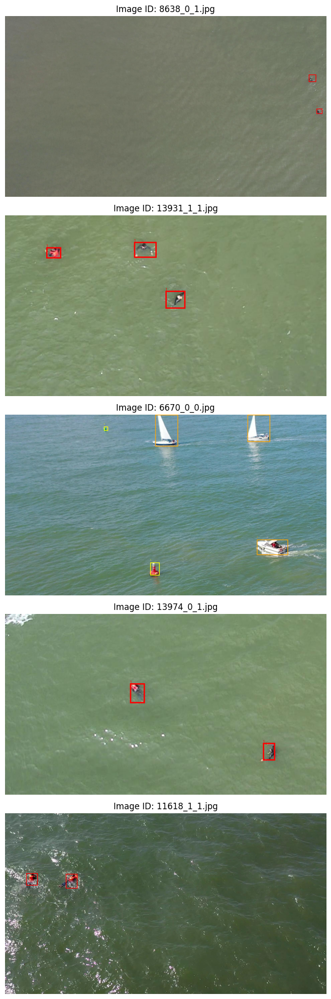

In [14]:
image_dir = '/content/SeaDroneSee/SeaDroneSee/output_patches/images/val'
annotation_path = '/content/SeaDroneSee/SeaDroneSee/output_patches/annotations/instances_patches_val.json'

visualize_patch_samples(image_dir,annotation_path,num_samples=5)

# Visualize Images From Train Data

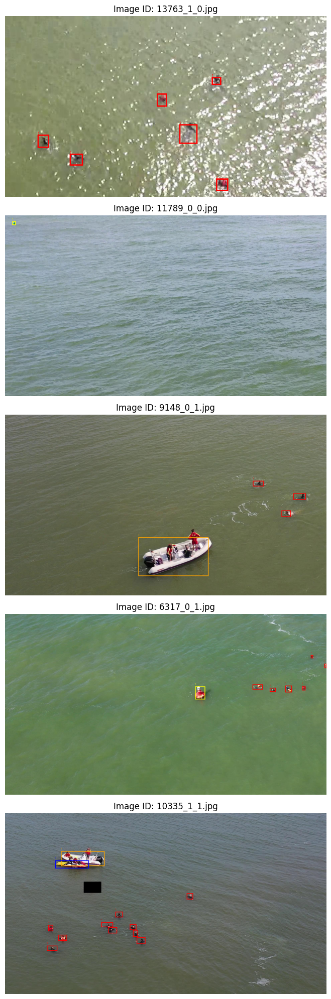

In [15]:
image_dir = '/content/SeaDroneSee/SeaDroneSee/output_patches/images/train'
annotation_path = '/content/SeaDroneSee/SeaDroneSee/output_patches/annotations/instances_patches_train.json'

visualize_patch_samples(image_dir,annotation_path,num_samples=5)

# **DataClass Preparation**

This line defines a dataclass named DatasetConfig for storing configuration parameters for a dataset.

In [16]:
@dataclass
class DatasetConfig:
    root: str
    annotations_file: str
    train_img_size: tuple
    subset: str = 'train'  # Default to 'train'
    transforms: any = None

* Define a custom dataset class to load aerial images, parse annotations, and prepare data for Faster R-CNN.
* It handles missing data, resizes images and boxes, and applies transformations for training.


In [17]:
class CustomAerialDataset(Dataset):
    def __init__(self, config: DatasetConfig):
        self.root = config.root
        self.transforms = config.transforms
        self.train_img_size = config.train_img_size
        self.subset = config.subset
        self.annotations_file = os.path.join(self.root, 'annotations', f'instances_patches_{self.subset}.json')
        self.imgs = []
        self.img_annotations = {}
        self._load_images()
        self._load_annotations()

    def __len__(self):
        return len(self.imgs)

    def _load_images(self):
        # Load all images from the subset directory
        images_path = os.path.join(self.root, 'images', self.subset)
        for image_filename in os.listdir(images_path):
            image_path = os.path.join(images_path, image_filename)
            if os.path.isfile(image_path) and image_path.endswith(('.png', '.jpg', '.jpeg')):
                self.imgs.append(image_path)
                image_id = os.path.basename(image_path)
                # Initialize empty annotations for each image
                if image_id not in self.img_annotations:
                    self.img_annotations[image_id] = {'boxes': [], 'labels': []}

    def _load_annotations(self):
        with open(self.annotations_file, 'r') as f:
            data = json.load(f)
        for annotation in data['annotations']:
            image_id = annotation["image_id"]
            bbox = annotation["bbox"]
            category_id = annotation["category_id"]
            image_path = os.path.join(self.root, 'images', self.subset, image_id)
            if image_id in self.img_annotations:
                self.img_annotations[image_id]['boxes'].append(bbox)
                self.img_annotations[image_id]['labels'].append(category_id)

    def __getitem__(self, idx):
        img_path = self.imgs[idx]
        if not os.path.exists(img_path):
            # Return a default image (like a zero tensor) and a dummy target
            default_img = torch.zeros(3, *self.train_img_size)  # Assuming 3 color channels
            default_target = {'boxes': torch.tensor([[0, 0, 0, 0]], dtype=torch.float32),
                              'labels': torch.tensor([0], dtype=torch.int64)}  # Background
            return default_img, default_target

        img = Image.open(img_path).convert("RGB")
        orig_width, orig_height = img.size
        scale_x = self.train_img_size[0] / orig_width
        scale_y = self.train_img_size[1] / orig_height
        img = img.resize(self.train_img_size, Image.BILINEAR)
        img = F.to_tensor(img)

        annotations = self.img_annotations[os.path.basename(img_path)]
        if annotations['boxes']:
            scaled_boxes = [[max(0, min(bbox[0] * scale_x, self.train_img_size[0])),
                             max(0, min(bbox[1] * scale_y, self.train_img_size[1])),
                             max(0, min((bbox[0] + bbox[2]) * scale_x, self.train_img_size[0])),
                             max(0, min((bbox[1] + bbox[3]) * scale_y, self.train_img_size[1]))]
                            for bbox in annotations['boxes']]
            labels = annotations['labels']
        else:
            scaled_boxes = [[0, 0, 0, 0]]
            labels = [0]

        boxes = torch.tensor(scaled_boxes, dtype=torch.float32)
        labels = torch.tensor(labels, dtype=torch.int64)

        target = {'boxes': boxes, 'labels': labels}
        if self.transforms:
            img, target = self.transforms(img, target)
        return img, target

# Data Transformation Function for Object Detection

In [18]:
def get_transform(train=True):
    transforms = [
        Tv2.ToDtype(torch.float, scale=True),
        Tv2.ToPureTensor(),
    ]

    if train:
        transforms.insert(0, Tv2.RandomHorizontalFlip(0.5))

    return Tv2.Compose(transforms)

# Custom Aerial Dataset for Object Detection

* CustomAerialDataset loads images and annotations, resizes them, and prepares the data for training.
* It converts bounding boxes from XYWH to XYXY format, supports transformations, and handles missing images safely.



In [19]:
root = "/content/SeaDroneSee/SeaDroneSee/output_patches"

train_dataset_config = DatasetConfig(
            root=root,
            annotations_file='annotations/instances_patches_train.json',
            train_img_size=(384,216),
            subset='train',
            transforms=get_transform(train=True))

val_dataset_config = DatasetConfig(
            root=root,
            annotations_file='annotations/instances_patches_val.json',
            train_img_size=(384, 216),
            subset='val',
            transforms=get_transform(train=False))



train_dataset = CustomAerialDataset(train_dataset_config)
val_dataset = CustomAerialDataset(val_dataset_config)

In [20]:
print(f"Length of Train Dataset: {len(train_dataset)}")
print(f"Length of Validation Dataset: {len(val_dataset)}")

Length of Train Dataset: 35720
Length of Validation Dataset: 6188


# Create an iterator for the dataset

In [21]:

train_iter = iter(train_dataset)
val_iter = iter(val_dataset)

# Fetch one sample from training and validation sets
train_img, train_target = next(train_iter)
val_img, val_target = next(val_iter)

# Print shapes
print("Train Image Shape:", train_img.shape)  # Should be (C, H, W)
print("Train Bounding Boxes Shape:", train_target["boxes"].shape)  # (num_boxes, 4)
print("Train Labels Shape:", train_target["labels"].shape)  # (num_boxes,)

print("\nVal Image Shape:", val_img.shape)
print("Val Bounding Boxes Shape:", val_target["boxes"].shape)
print("Val Labels Shape:", val_target["labels"].shape)


Train Image Shape: torch.Size([3, 216, 384])
Train Bounding Boxes Shape: torch.Size([2, 4])
Train Labels Shape: torch.Size([2])

Val Image Shape: torch.Size([3, 216, 384])
Val Bounding Boxes Shape: torch.Size([4, 4])
Val Labels Shape: torch.Size([4])


* Final dataset includes 35,270 training and 6,188 validation images.
* A custom collate function handles images without annotations to reduce false positives and improve performance.


In [22]:
def collate_fn(batch):
    imgs, targets = zip(*batch)
    imgs = torch.stack(imgs, dim=0)
    real_targets = []
    for target in targets:
        # Filter out dummy boxes
        mask = target['boxes'].sum(dim=1) > 0
        real_targets.append({'boxes': target['boxes'][mask], 'labels': target['labels'][mask]})
    return imgs, real_targets

train_data_loader = DataLoader(train_dataset, batch_size=5, shuffle=True, collate_fn=collate_fn, num_workers=12)
val_data_loader = DataLoader(val_dataset, batch_size=5, shuffle=False, collate_fn=collate_fn, num_workers=12)

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


###  samples visualization from the train_data_loader to check that custom data dataset class is properly defined.

(384, 216)
(384, 216)
(384, 216)
(384, 216)
(384, 216)


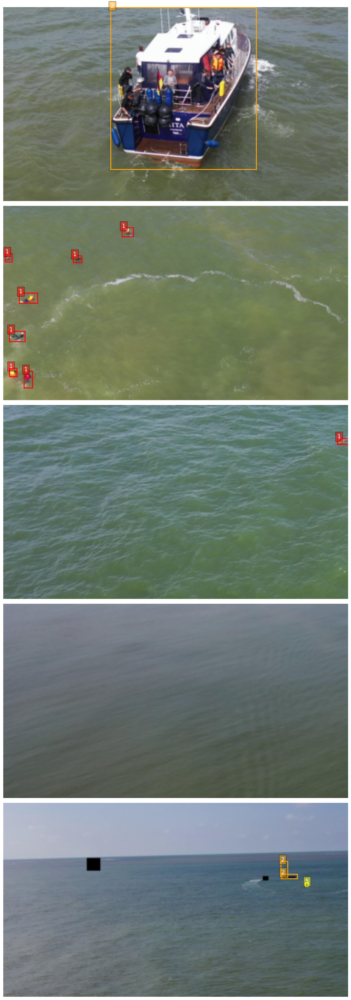

In [24]:
def show_image_with_boxes(img, targets, ax, category_colors):
    """Plot an image with its bounding boxes on an axis object."""
    # Convert tensor image to PIL for display if needed
    if isinstance(img, torch.Tensor):
        img = to_pil_image(img)
        print(img.size)
    ax.imshow(img)

    # Check and plot each bounding box with class-specific color
    if 'boxes' in targets and 'labels' in targets:
        boxes = targets['boxes'].cpu().numpy()
        labels = targets['labels'].cpu().numpy()
        for bbox, label in zip(boxes, labels):
            w = bbox[2]-bbox[0]
            h = bbox[3]-bbox[1]
            color = category_colors.get(label, 'gray')  # Use gray for unmapped classes
            rect = patches.Rectangle((bbox[0], bbox[1]), w, h, linewidth=2, edgecolor=color, facecolor='none')
            ax.add_patch(rect)
            ax.text(bbox[0], bbox[1], str(label), color='white', fontsize=12, bbox=dict(facecolor=color, alpha=0.5))

def visualize_samples(data_loader, category_colors, num_samples=20):
    """Visualize a specified number of samples from a DataLoader in a single column."""
    num_rows = num_samples  # All samples in a single column
    num_cols = 1
    fig, axs = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(15, 25 * num_rows // 4))  # Adjust height based on rows
    samples_visualized = 0

    for images, targets in data_loader:
        for i, ax in enumerate(axs.flat):
            if samples_visualized >= num_samples:
                break  # Stop after displaying the desired number of samples

            show_image_with_boxes(images[i], targets[i], ax, category_colors)
            ax.axis('off')  # Turn off axis for cleaner look
            samples_visualized += 1

        # enough samples visualized, break the loop to avoid extra iterations
        if samples_visualized >= num_samples:
            break

    plt.tight_layout()
    plt.show()


# Assuming train_data_loader is defined and loaded correctly
visualize_samples(train_data_loader, category_colors, num_samples=5)


(384, 216)
(384, 216)
(384, 216)
(384, 216)
(384, 216)


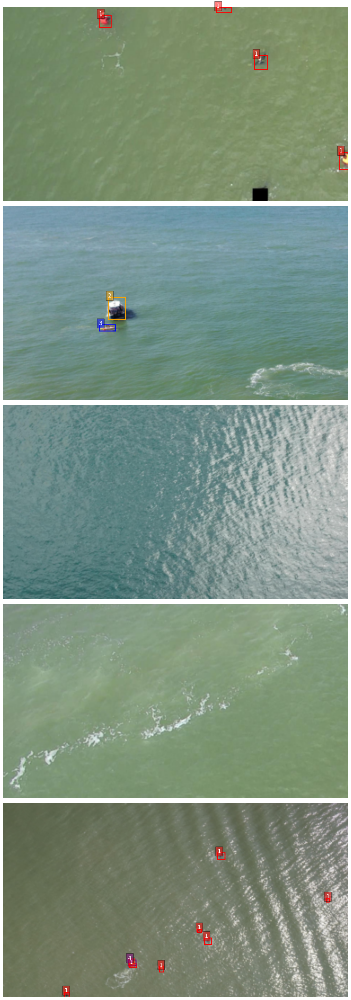

In [25]:
visualize_samples(val_data_loader, category_colors, num_samples=5)

# Function to visualize predictions with ground truth and predicted bounding boxes

In [26]:

def create_directory(path):
    """Create a directory if it does not exist."""
    if not os.path.exists(path):
        os.makedirs(path)

def visualize_predictions(images, outputs, targets, save_dir, epoch, writer):
    """
    Visualizes ground truth and predicted bounding boxes on images.

    Args:
        images (list of torch.Tensor): List of image tensors.
        outputs (list of dicts): Model predictions containing 'boxes' and 'labels'.
        targets (list of dicts): Ground truth containing 'boxes' and 'labels'.
        save_dir (str): Directory to save the visualizations.
        epoch (int): Current training epoch.
        writer (SummaryWriter): TensorBoard writer for logging images.

    Returns:
        list: List of figure objects for further processing.
    """
    create_directory(save_dir)
    figures = []

    for idx, (image, output, target) in enumerate(zip(images, outputs, targets)):
        try:
            # Convert image tensor to numpy array and clip values to [0, 1] range
            image = image.permute(1, 2, 0).cpu().numpy()
            image = np.clip(image, 0, 1)

            fig, ax = plt.subplots(figsize=(8, 8))
            ax.imshow(image)

            # Plot ground truth bounding boxes
            for box, label in zip(target['boxes'], target['labels']):
                box = box.cpu().numpy()
                xmin, ymin, xmax, ymax = box
                color = category_colors.get(label.item(), 'blue')
                rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=False, edgecolor=color, linewidth=2)
                ax.add_patch(rect)
                ax.text(xmin, ymin, f'{classes_to_idx[label.item()]} ({label.item()})',
                        bbox=dict(facecolor=color, alpha=0.5), color='white')

            # Plot predicted bounding boxes
            for box, label in zip(output['boxes'], output['labels']):
                box = box.cpu().numpy()
                xmin, ymin, xmax, ymax = box
                rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=False, edgecolor='red', linewidth=2)
                ax.add_patch(rect)
                ax.text(xmin, ymin, f'Pred: {label.item()}',
                        bbox=dict(facecolor='red', alpha=0.5), color='white')

            ax.axis('off')
            plt.tight_layout()

            # Save the visualization
            save_path = os.path.join(save_dir, f'prediction_epoch_{epoch}_image_{idx}.png')
            plt.savefig(save_path, bbox_inches='tight', dpi=300)
            writer.add_figure(f'Predictions/epoch_{epoch}_image_{idx}', fig, epoch)

            figures.append(fig)
            plt.close(fig)
        except Exception as e:
            print(f"Error while visualizing prediction for index {idx}: {e}")

    return figures


# MODEL CONFIGURATION:
* Using pretrained Faster R-CNN with MobileNet v3 backbone (lightweight, Colab-friendly).
* Modified final layer for 6 SeaDroneSee classes.
* Optimizer: SGD with momentum=0.9, lr=5e-4, and StepLR scheduler at mid-training.


In [27]:
def create_model(num_classes):
    model = torchvision.models.detection.fasterrcnn_mobilenet_v3_large_fpn(weights="DEFAULT")
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model
num_classes=6
model=create_model(num_classes)
model.to(device)
model

Downloading: "https://download.pytorch.org/models/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth
100%|██████████| 74.2M/74.2M [00:00<00:00, 149MB/s]


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): FrozenBatchNorm2d(16, eps=1e-05)
        (2): Hardswish()
      )
      (1): InvertedResidual(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
            (2): ReLU(inplace=True)
          )
          (1): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
          )
        )
      )
      (2): InvertedResidual(
        (block):

# TRAINING:
* Using Mixed Precision (AMP) to speed up training with less memory.
* Metrics (loss, accuracy) logged with TensorBoard.
* Model trains in batches, with optimizer + scheduler updates per epoch

In [28]:
def train_one_epoch(model, data_loader, device, optimizer, print_freq, epoch, scaler=None):
    model.train()
    metric_logger = MetricLogger(delimiter="  ")
    metric_logger.add_meter("lr", SmoothedValue(window_size=1, fmt="{value:.6f}"))
    header = f"Training Epoch {epoch}:"

    with tqdm(data_loader, desc=header, leave=False) as tq:
        for i, (images, targets) in enumerate(tq):
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            with torch.amp.autocast('cuda', enabled=scaler is not None):  # Updated for PyTorch 2.x
                loss_dict = model(images, targets)
                losses = sum(loss for loss in loss_dict.values())

            optimizer.zero_grad()
            if scaler is not None:
                scaler.scale(losses).backward()
                scaler.step(optimizer)
                scaler.update()
            else:
                losses.backward()
                optimizer.step()

            metric_logger.update(loss=losses, **loss_dict)
            metric_logger.update(lr=optimizer.param_groups[0]["lr"])

            if i % print_freq == 0:
                tq.set_postfix(loss=losses.item(), lr=optimizer.param_groups[0]["lr"])

            global_step = epoch * len(data_loader) + i
            writer.add_scalar('Loss/train', losses.item(), global_step)
            for k, v in loss_dict.items():
                writer.add_scalar(f'Loss/train_{k}', v.item(), global_step)

    avg_loss = metric_logger.meters['loss'].global_avg
    print(f"{header} Average Loss: {avg_loss:.4f}")
    writer.add_scalar('Loss/avg_train', avg_loss, epoch)
    return avg_loss


# Evaluation function

In [29]:
def evaluate(model, data_loader, device, epoch, save_dir):
    model.eval()
    metric = MeanAveragePrecision(iou_type="bbox")
    header = f"Validation Epoch {epoch}:"

    with torch.no_grad(), tqdm(data_loader, desc=header, leave=False) as tq:
        for images, targets in tq:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            outputs = model(images)

            preds = [{"boxes": out["boxes"], "scores": out["scores"], "labels": out["labels"]} for out in outputs]
            targs = [{"boxes": tgt["boxes"], "labels": tgt["labels"]} for tgt in targets]
            metric.update(preds, targs)

    results = metric.compute()
    table_data = [
        ["mAP", f"{results['map'].item():.4f}"],
        ["mAP@50IoU", f"{results['map_50'].item():.4f}"],
        ["mAP@75IoU", f"{results['map_75'].item():.4f}"],
        ["mAP Small", f"{results['map_small'].item():.4f}" if results['map_small'].item() >= 0 else "N/A"],
        ["mAP Medium", f"{results['map_medium'].item():.4f}" if results['map_medium'].item() >= 0 else "N/A"],
        ["mAP Large", f"{results['map_large'].item():.4f}" if results['map_large'].item() >= 0 else "N/A"],
    ]
    print(f"\n{header} Metrics:")
    print(tabulate(table_data, headers=["Metric", "Value"], tablefmt="grid"))

    # Log metrics to TensorBoard
    for k, v in results.items():
        if v.numel() == 1:  # Scalar values
            writer.add_scalar(f'mAP/{k}', v.item(), epoch)
        else:  # Multi-element tensors (e.g., mar_1, mar_10)
            for i, val in enumerate(v):
                writer.add_scalar(f'mAP/{k}_{i}', val.item(), epoch)

    return results


# Main training loop

In [30]:
# Main training loop
def main():
    # Hyperparameters
    total_epochs = 3
    num_classes = 6
    num_epochs = total_epochs
    print_freq = 50
    best_map = -1.0

    # Assuming 'model', 'train_data_loader', and 'val_data_loader' are already defined
    if 'model' not in globals() or 'train_data_loader' not in globals() or 'val_data_loader' not in globals():
        raise NameError("model, train_data_loader, and val_data_loader must be defined before running main()")

    # Optimizer, scheduler, and scaler
    optimizer = optim.SGD(model.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)
    lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=total_epochs // 2, gamma=0.1)
    scaler = torch.amp.GradScaler() if torch.cuda.is_available() else None

    # TensorBoard writer
    global writer
    writer = SummaryWriter(log_dir='/content/runs/aerial_detection')

    # Save directory
    save_dir = "/content/prediction_val"
    os.makedirs(save_dir, exist_ok=True)

    # Training loop
    for epoch in range(num_epochs):
        torch.cuda.empty_cache()
        gc.collect()
        train_one_epoch(model, train_data_loader, device, optimizer, print_freq, epoch, scaler)
        results = evaluate(model, val_data_loader, device, epoch, save_dir)
        lr_scheduler.step()  # Update learning rate after each epoch

        current_map = results['map'].item()
        if current_map > best_map:
            best_map = current_map
            checkpoint = {
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'best_map': best_map,
                'scaler': scaler.state_dict() if scaler is not None else None
            }
            torch.save(checkpoint, f'{save_dir}/best_model_epoch_{epoch}.pth')
            print(f"Saved best model with mAP: {best_map:.4f}")

    print("Training complete!")
    writer.close()

# TensorBoard in Colab
%reload_ext tensorboard
%tensorboard --logdir /content/runs

if __name__ == "__main__":
    main()

<IPython.core.display.Javascript object>

Training Epoch 0::   0%|          | 0/7144 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Training Epoch 0: Average Loss: 0.2080



Validation Epoch 0: Metrics:
+------------+---------+
| Metric     |   Value |
+============+=========+
| mAP        |  0.2743 |
+------------+---------+
| mAP@50IoU  |  0.5719 |
+------------+---------+
| mAP@75IoU  |  0.2271 |
+------------+---------+
| mAP Small  |  0.2679 |
+------------+---------+
| mAP Medium |  0.4592 |
+------------+---------+
| mAP Large  |  0.5204 |
+------------+---------+
Saved best model with mAP: 0.2743


Training Epoch 1: Average Loss: 0.1920



Validation Epoch 1: Metrics:
+------------+---------+
| Metric     |   Value |
+============+=========+
| mAP        |  0.3174 |
+------------+---------+
| mAP@50IoU  |  0.6112 |
+------------+---------+
| mAP@75IoU  |  0.2905 |
+------------+---------+
| mAP Small  |  0.3158 |
+------------+---------+
| mAP Medium |  0.4807 |
+------------+---------+
| mAP Large  |  0.4973 |
+------------+---------+
Saved best model with mAP: 0.3174


Training Epoch 2: Average Loss: 0.1921



Validation Epoch 2: Metrics:
+------------+---------+
| Metric     |   Value |
+============+=========+
| mAP        |  0.3183 |
+------------+---------+
| mAP@50IoU  |  0.616  |
+------------+---------+
| mAP@75IoU  |  0.2848 |
+------------+---------+
| mAP Small  |  0.3158 |
+------------+---------+
| mAP Medium |  0.4787 |
+------------+---------+
| mAP Large  |  0.5193 |
+------------+---------+
Saved best model with mAP: 0.3183
Training complete!


In [31]:
!ls /content/runs/aerial_detection

events.out.tfevents.1744272546.b7a566db90d5.284.0


# Load Checkpoint

In [32]:
checkpoint_path = "/content/prediction_val/best_model_epoch_2.pth"
# Function to load the trained model
def load_model(checkpoint_path, device):
    model = detection.fasterrcnn_mobilenet_v3_large_fpn(pretrained=False, num_classes=len(classes_to_idx),box_nms_thresh=0.3)
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    model.to(device)
    model.eval()
    return model

In [33]:
model = load_model(checkpoint_path, device)
model

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-8738ca79.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_large-8738ca79.pth
100%|██████████| 21.1M/21.1M [00:00<00:00, 102MB/s]


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): FrozenBatchNorm2d(16, eps=1e-05)
        (2): Hardswish()
      )
      (1): InvertedResidual(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
            (2): ReLU(inplace=True)
          )
          (1): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
          )
        )
      )
      (2): InvertedResidual(
        (block):

*  The show_image_with_boxes function takes the image tensor and prediction bounding boxes and converts them to a PIL object.

In [34]:
def create_directory(path):
    """Create a directory if it doesn't exist."""
    os.makedirs(path, exist_ok=True)

def show_image_with_boxes(img, targets, ax, category_colors, classes_to_idx):
    """Display an image with bounding boxes and class labels."""
    img = to_pil_image(img) if isinstance(img, torch.Tensor) else img
    ax.imshow(img)
    ax.axis('off')

    if {'boxes', 'labels', 'scores'}.issubset(targets):
        boxes, labels, scores = (targets[key].cpu().numpy() for key in ['boxes', 'labels', 'scores'])
        for bbox, label, score in zip(boxes, labels, scores):
            if score >= 0.5:  # Show only boxes with confidence >= 0.5
                x, y, x_max, y_max = bbox
                w, h = x_max - x, y_max - y
                color = category_colors.get(label, 'gray')
                ax.add_patch(patches.Rectangle((x, y), w, h, linewidth=2, edgecolor=color, facecolor='none'))
                ax.text(x, y, f'{classes_to_idx[label]}', color='white', fontsize=8,
                        bbox=dict(facecolor=color, alpha=0.5))

def visualize_samples(images, outputs, category_colors, classes_to_idx, num_samples=10):
    """Visualize multiple images with bounding boxes in a vertical layout."""
    num_samples = min(num_samples, len(images))
    fig, axs = plt.subplots(nrows=num_samples, figsize=(15, 3 * num_samples))
    axs = axs if num_samples > 1 else [axs]  # Ensure axs is iterable

    for ax, img, output in zip(axs, images[:num_samples], outputs[:num_samples]):
        show_image_with_boxes(img.cpu(), output, ax, category_colors, classes_to_idx)

    plt.tight_layout()
    plt.show()


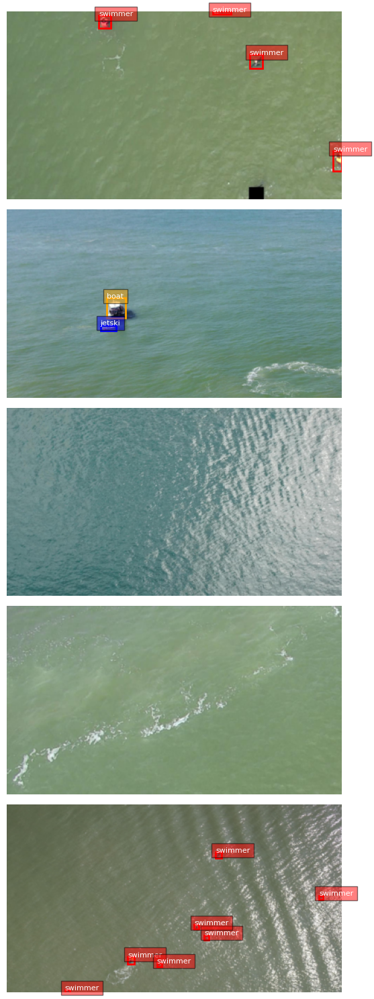

In [35]:
# Perform predictions and visualize
images = []
outputs = []
with torch.no_grad():
    for i, (image_batch, _) in enumerate(val_data_loader):
        if len(images) >= 10:
            break
        for image in image_batch:
            if len(images) >= 10:
                break
            image = image.to(device)
            output = model([image])
            if len(output) > 0:  # Ensure there is at least one prediction
                images.append(image)
                outputs.append({k: v for k, v in output[0].items()})

# Visualize the predictions
visualize_samples(images, outputs, category_colors,classes_to_idx, num_samples=5)

# Test Images

In [36]:
output_dir = '/content/patches_test'
os.makedirs(output_dir, exist_ok=True)

In [37]:
def check_and_rotate_image(image):
    """Rotate the image if its height is greater than its width and return the image and a flag indicating rotation."""
    width, height = image.size
    if height > width:
        image = image.rotate(90, expand=True)  # Rotates 90 counter-clockwise
        return image, True
    return image, False

In [38]:
def create_patches(image, output_dir, image_filename, overlap_ratio=0.2):
    """Create image patches and handle image rotation if necessary."""
    image, was_rotated = check_and_rotate_image(image)
    width, height = image.size

    patch_width = int(width / 2)
    patch_height = int(height / 2)
    overlap_width = int(patch_width * overlap_ratio)
    overlap_height = int(patch_height * overlap_ratio)

    patches = []
    for i in range(2):  # Three rows
        for j in range(2):  # Three columns
            left = i * (patch_width - overlap_width)
            top = j * (patch_height - overlap_height)
            right = left + patch_width
            bottom = top + patch_height
            patch = image.crop((left, top, right, bottom))
            patch_filename = f'{os.path.splitext(image_filename)[0]}_{i}_{j}.jpg'
            patch_path = os.path.join(output_dir, patch_filename)
            patch.save(patch_path)
            patches.append((patch_filename, left, top, right, bottom, was_rotated))

    return patches

image_path = 'SeaDroneSee/test/1669.jpg'
img_filename = os.path.basename(image_path)
img_filename_temp = img_filename.split('.')[0]
img = Image.open(image_path)
create_patches(img, output_dir, img_filename, overlap_ratio=0.2)


[('1669_0_0.jpg', 0, 0, 2728, 1816, False),
 ('1669_0_1.jpg', 0, 1453, 2728, 3269, False),
 ('1669_1_0.jpg', 2183, 0, 4911, 1816, False),
 ('1669_1_1.jpg', 2183, 1453, 4911, 3269, False)]

# With Patches

In [39]:
def get_transform():
    transforms = []
    transforms.append(Tv2.ToDtype(torch.float, scale=True))
    transforms.append(Tv2.ToPureTensor())
    return Tv2.Compose(transforms)


# Function to show image with bounding boxes and save it to disk
def show_image_with_boxes(img, targets, category_colors, classes_to_idx, output_path):
    fig, ax = plt.subplots(1, figsize=(12, 9))
    ax.imshow(img)
    boxes = targets['boxes'].cpu().numpy()
    labels = targets['labels'].cpu().numpy()
    scores = targets['scores'].cpu().numpy()
    for bbox, label, score in zip(boxes, labels, scores):
        if score >= 0.3:  # Only show boxes with confidence score >= 0.3
            w = bbox[2] - bbox[0]
            h = bbox[3] - bbox[1]
            color = category_colors.get(label, 'gray')  # Use gray for unmapped classes
            rect = patches.Rectangle((bbox[0], bbox[1]), w, h, linewidth=2, edgecolor=color, facecolor='none')
            ax.add_patch(rect)
            # ax.text(bbox[0], bbox[1], f'{classes_to_idx[label]}: {score:.2f}', color='white', fontsize=12, bbox=dict(facecolor=color, alpha=0.5))
    plt.axis('off')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0.1)
    plt.show()
    # plt.close()

# Function to predict and visualize the output for a single image
def predict_and_visualize(image_path, model, device, category_colors, classes_to_idx, output_path):
    # Load and transform the image
    transforms = get_transform()

    img = PIL.Image.open(image_path).convert("RGB")
    img = img.resize((382, 216), PIL.Image.BILINEAR)  # Resize the image
    # print(img.size)
    img_tensor = F.to_tensor(img)
    img_trans = transforms(img_tensor).to("cuda:0")


    # Perform prediction
    with torch.no_grad():
        output = model(torch.unsqueeze(img_trans,dim=0))[0]

    # Visualize and save the output
    show_image_with_boxes(img, output, category_colors, classes_to_idx, output_path)

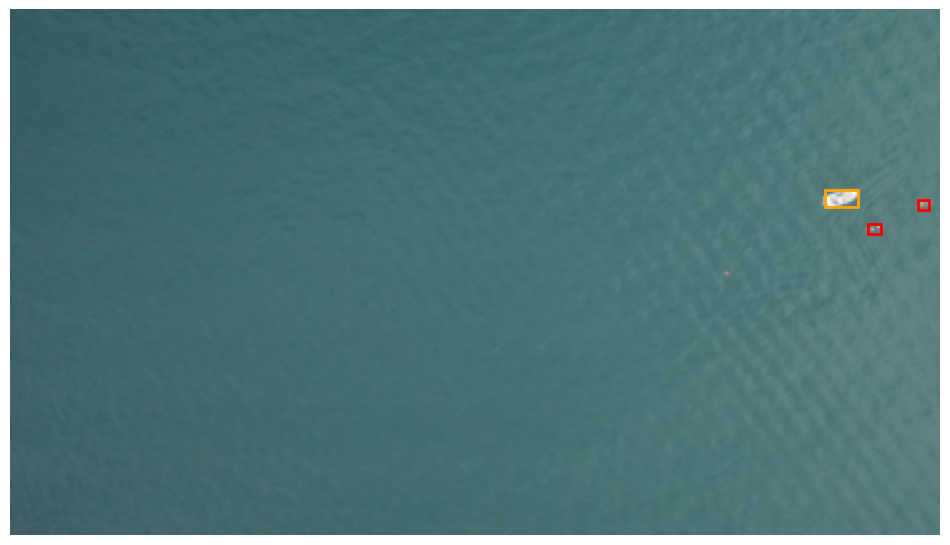

In [40]:
# Example usage
image_path = "/content/patches_test/1669_0_1.jpg"
os.makedirs('/content/patches_test/outputs', exist_ok=True)  # Ensure the output directory exists
output_path = '/content/patches_test/outputs/output_image.jpg'  # Path to save the output image

# Predict and visualize the output for the single image
predict_and_visualize(image_path, model, device, category_colors, classes_to_idx, output_path)


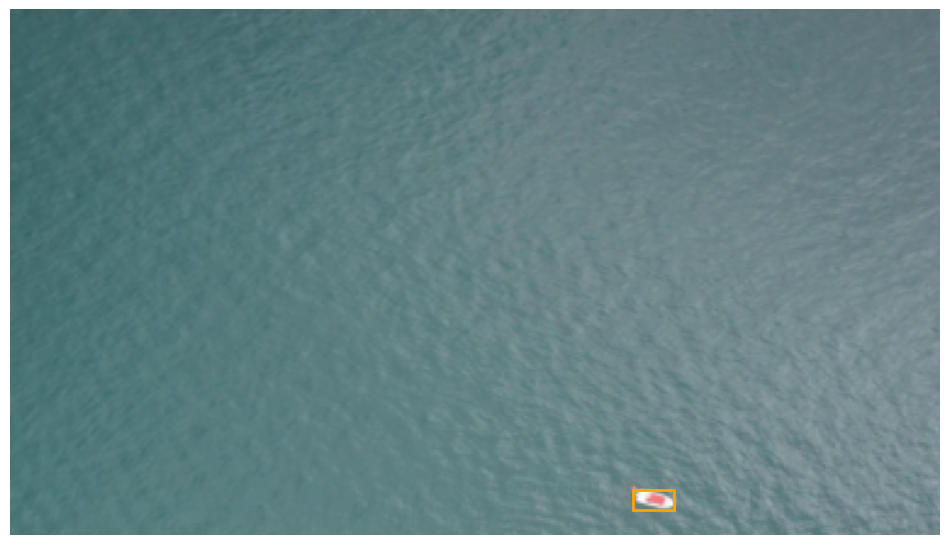

In [41]:
# Example usage
image_path = "/content/patches_test/1669_1_0.jpg"
os.makedirs('/content/patches_test/outputs', exist_ok=True)  # Ensure the output directory exists
output_path = '/content/patches_test/outputs/output_image.jpg'  # Path to save the output image

# Predict and visualize the output for the single image
predict_and_visualize(image_path, model, device, category_colors, classes_to_idx, output_path)